# Circular Consensus
Distributed Target Localization and Encirclement with a Multi-robot System [Franchi, 2010]

![alt text][id]
[id]: doc_figs/circulant.png "Title"


**->Swarms**



In [1]:
import matplotlib 
matplotlib.rc('xtick', labelsize=15) 
matplotlib.rc('ytick', labelsize=15) 


matplotlib.rcParams['ps.useafm'] = True
matplotlib.rcParams['pdf.use14corefonts'] = True
matplotlib.rcParams['text.usetex'] = True

Populating the interactive namespace from numpy and matplotlib


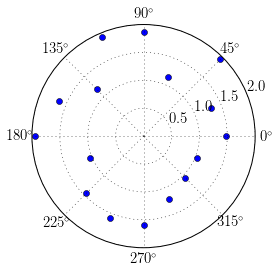

In [2]:
%pylab inline

t = np.linspace(0,30,200)
t = np.linspace(0,45,300)

# Desired radius
R = 1.5
# Desired angular speed
Omeg = .01
#Omeg = 0.
    
# Polar coordinates
n = 16
rho = 1. + 1. * np.random.rand(n)
phi = sort(2 * pi * np.random.rand(n))


#rho = np.ones(n)
phi = np.linspace(0,2*pi, n, endpoint=False) #+ .6 *np.random.rand(n)


plt.polar(phi, rho, 'o')




In [3]:
import pylab
pylab.rcParams['figure.figsize'] = (6.0, 6.0)
#pylab.rcParams['figure.figsize'] = (6.0, 4.0)

## Encirclement task
Rereference outputs
$$
\dot \rho ^r_i = K_\rho (R-\rho_i^r)
$$

$$
\dot \phi_i^r = \Omega + K_\phi(\bar \phi^r_i-\phi^r_i)
$$

# Malicious agent

In [4]:
def run_encirclement(n, phi, rho, neigh=1, malicius=[]):
    """
    neigh=1 means one neighbor in front and one back.
    """
    # Number of malicious agents
    F = len(malicius)
    
    # Trajectories
    traj_rho = [copy(rho)]
    traj_phi = [copy(phi)]
    
    # Trajectories communications
    traj_rho_comm = [copy(rho)]
    traj_phi_comm = [copy(phi)]
    
    # gain constants
    kp, kphi = .1, .00

    conns = []
    
    for ti in t:
        T = 8.5        
        PHI_COMM = math.pi/4.5
        # Adjacency matrix, based on phi
        conn = np.array([[diff_ang(i,j) for j in phi] for i in phi])
        conn = (abs(conn)<PHI_COMM)*1. - np.identity(n)        
        conns.append(conn)
        
        # old neighbors
        old_neigh = conns[-50:]
                
        # For each agent
        for i in range(n):
            # Phi for communication
            phi_comm = copy(phi)
            rho_comm = copy(rho)
            
            # Malicious agent
            for mi in malicius:
                phi_comm[mi] = 0
                rho_comm[mi] = 1.5+.5*math.sin(10*ti/T)
            

            
            
            # Neighbor indexes            
            neig = np.where(conn[i])
            # Rho from neighbors and i
            neig_rho = np.hstack((rho_comm[neig], rho[i]))
            brho = sum(neig_rho)/len(neig_rho)
            
            rho[i] += kp * (brho - rho[i])
                                    
                                    
            # Average
            phi_av = sum([phi_comm[i-j] for j in range(1, 1+neigh)] +
                         [phi_comm[(i+j) % n] for j in range(1, 1+neigh)]) / (2*neigh)
                       
            # Compensation for border nodes.
            if i < neigh:
                phi_av -= (neigh-i) * pi / neigh
            elif i >= n-neigh:
                phi_av += (i - n + neigh + 1) * pi / neigh            


            
            ### Oscillatory behavior
            a = .03
            
            phi[i] += Omeg
                        

        traj_rho.append(copy(rho))
        traj_phi.append(copy(phi))
        traj_rho_comm.append(copy(rho_comm))
        traj_phi_comm.append(copy(phi_comm))
        

    traj_rho = np.array(traj_rho)
    traj_phi = np.array(traj_phi)
    traj_rho_comm = np.array(traj_rho_comm)
    traj_phi_comm = np.array(traj_phi_comm)
    
    dot_phi = traj_phi[1:,:]-traj_phi[:-1,:]
    
    return traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns

#plt.savefig('metric%.2f.pdf'%vel, bbox_inches="tight")

In [5]:
# Rho convergence
def draw_rho(traj_rho_comm):    
    plt.plot(traj_rho_comm[:,0], 'r')
    
    for i in range(n)[1:]:
        plt.plot(traj_rho_comm[:,i], label="$r_%i$"%i)
        
    ## The last good camera
    plt.xlabel('$t $',fontsize=22)
    plt.ylabel('$\\rho_i $',fontsize=22)
    
diff_ang = lambda i,j: math.atan2(math.sin(i-j), math.cos(i-j))
diff_ang(math.pi/2,math.pi/2)

0.0

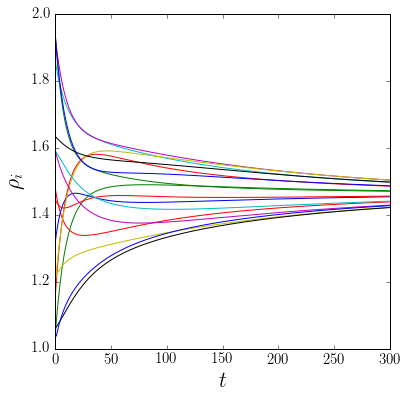

In [6]:
traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns = run_encirclement(n, copy(phi), copy(rho), neigh=1,
        malicius=[])

draw_rho(traj_rho_comm)
plt.savefig('rho_normal.pdf', bbox_inches="tight")

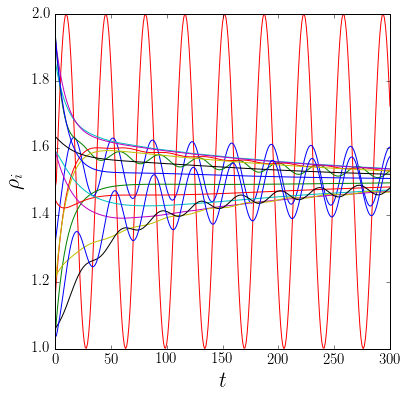

In [7]:
traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns = run_encirclement(n, copy(phi), copy(rho), neigh=1,
        malicius=[0])

draw_rho(traj_rho_comm)

plt.savefig('rho_mal.pdf', bbox_inches="tight")

# Encirclement task with TWMSR

In [8]:
i=0

def get_T_neighs(i, conns, traj_rho, n_T = 80, nv = -1000):
    """
    " n_T: number of values for T.
    " nv: negative value
    """
    # Last connections
    lconns = conns[-n_T:]    
    # Get neighbors in time
    neighi = np.array([(j-len(lconns))*conn[i] for j,conn in enumerate(lconns)])    
    # Replace zeros by a big negative value
    neighi[neighi==0.] = nv    
    # Most recent neighbors in time
    neighi = np.max(neighi,axis=0)        
    # vals from neighs
    vals = [traj_rho[int(t2)][j] for j, t2 in enumerate(neighi) if t2 != nv]
    return np.array(vals)

#$vals = get_T_neighs(i, conns[:1], traj_rho[:1])
#vals


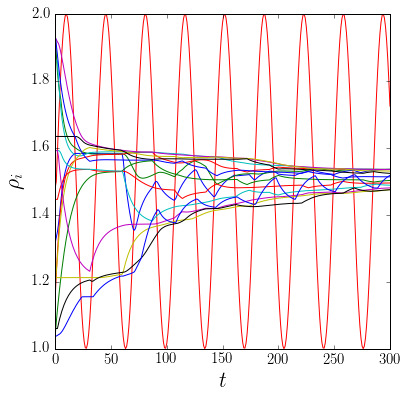

In [9]:
def run_encirclement(n, phi, rho, neigh=1, malicius=[]):
    """
    neigh=1 means one neighbor in front and one back.
    """
    # Number of malicious agents
    F = len(malicius)
    
    # Trajectories
    traj_rho = [copy(rho)]
    traj_phi = [copy(phi)]
    
    # Trajectories communications
    traj_rho_comm = [copy(rho)]
    traj_phi_comm = [copy(phi)]
    
    # gain constants
    kp, kphi = .1, .00

    conns = []
    
    for ti in t:
        T = 8.5        
        PHI_COMM = math.pi/4.5
        # Adjacency matrix, based on phi
        conn = np.array([[diff_ang(i,j) for j in phi] for i in phi])
        conn = (abs(conn)<PHI_COMM)*1. - np.identity(n)        
        conns.append(conn)
        
        # old neighbors
        old_neigh = conns[-50:]
                
        # For each agent
        for i in range(n):
            # Phi for communication
            phi_comm = copy(phi)
            rho_comm = copy(rho)
            
            # Malicious agent
            for mi in malicius:
                phi_comm[mi] = 0
                rho_comm[mi] = 1.5+.5*math.sin(10*ti/T)
            
            ###### TW-MSR
            ## Get information 
            #last=t[ti - T < t]
            #tii, tif = np.where(t==last[0])[0], np.where(t==ti)[0]
            #interval_inx = np.linspace(tii,tif, tif-tii-1)
            #print tif - tii, tif
            
            # Values from neighbors
            neig_rhoT = get_T_neighs(i, conns, traj_rho_comm)
            
            # Remove outlayers
            smallers = sort(neig_rhoT[neig_rhoT<rho[i]])
            largers = sort(neig_rhoT[neig_rhoT>rho[i]])
            
             
            neig_rhoT = np.hstack((smallers[F:], largers[:-F]))
            
            if i == 1 and False:  # Debug
                print rho[i], smallers, largers, neig_rhoT
            
            # If no info from neighbors
            if len(neig_rhoT):
                brho = sum(neig_rhoT)/len(neig_rhoT)
            else:
                brho = rho[i]
            
            
            # Neighbor indexes
            #neig = np.where(conn[i])
            # Rho from neighbors and i
            #neig_rho = np.hstack((rho_comm[neig], rho[i]))
            #brho = sum(neig_rho)/len(neig_rho)
            
            rho[i] += kp * (brho - rho[i])
                                    
                                    
            # Average
            phi_av = sum([phi_comm[i-j] for j in range(1, 1+neigh)] +
                         [phi_comm[(i+j) % n] for j in range(1, 1+neigh)]) / (2*neigh)
                       
            # Compensation for border nodes.
            if i < neigh:
                phi_av -= (neigh-i) * pi / neigh
            elif i >= n-neigh:
                phi_av += (i - n + neigh + 1) * pi / neigh            

            # Dot phi
            #phi[i] += Omeg + kphi * (phi_av - phi[i])
            
            ### Oscillatory behavior
            a = .03
            
            if int(ti/T)%2==0:
                if i%4 == 0:                
                    phi[i] += Omeg + a * math.sin(2*math.pi * ti/T + pi/2)            
                elif i%2 == 0:
                    phi[i] += Omeg - a * math.sin(2*math.pi * ti/T + pi/2) 
                else:
                    phi[i] += Omeg
            else:
                if (i in [3,7,11]):
                #if i%3 == 0:                
                    phi[i] += Omeg + a * math.sin(2*math.pi * ti/T + pi/2)            
                #elif i%1 == 0:
                elif (i in [1,5,9]):
                    phi[i] += Omeg - a * math.sin(2*math.pi * ti/T + pi/2) 
                else:
                    phi[i] += Omeg

        traj_rho.append(copy(rho))
        traj_phi.append(copy(phi))
        traj_rho_comm.append(copy(rho_comm))
        traj_phi_comm.append(copy(phi_comm))
        

    traj_rho = np.array(traj_rho)
    traj_phi = np.array(traj_phi)
    traj_rho_comm = np.array(traj_rho_comm)
    traj_phi_comm = np.array(traj_phi_comm)
    
    dot_phi = traj_phi[1:,:]-traj_phi[:-1,:]
    
    return traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns

malicius=[0]
traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns = run_encirclement(n, copy(phi), copy(rho), neigh=1,
        malicius=malicius)


draw_rho(traj_rho_comm)

#plt.savefig('rho_twmsr.pdf', bbox_inches="tight")

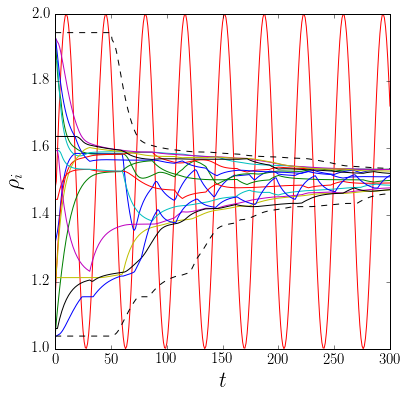

In [10]:
# Rho convergence
def draw_rho(traj_rho_comm):
    
    plt.plot(traj_rho_comm[:,0], 'r')
    
    for i in range(n)[1:]:
        plt.plot(traj_rho_comm[:,i], label="$r_%i$"%i)
        
    # max
    max1, min1 = [], []
    T = 50
    for t in range(len(traj_rho_comm)):
        t1 = t-50 if t-50>0 else 0
        max1.append(np.max(traj_rho_comm[t1:t+1,1:]))
        min1.append(np.min(traj_rho_comm[t1:t+1,1:]))
    
    plt.plot(max1, 'k--')
    plt.plot(min1, 'k--')
        
    ## The last good camera
    plt.xlabel('$t $',fontsize=22)
    plt.ylabel('$\\rho_i $',fontsize=22)

draw_rho(traj_rho_comm)
plt.savefig('rho_twmsr.pdf', bbox_inches="tight")

/usr/lib/python2.7/dist-packages/matplotlib/cbook.py:137: MatplotlibDeprecationWarning: The set_color_cycle attribute was deprecated in version 1.5. Use set_prop_cycle instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


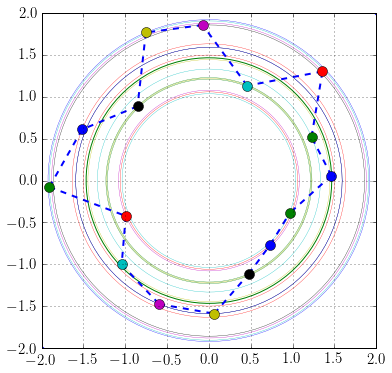

In [11]:
t1 = 1
xsize, ysize = (-2, 2),(-2, 2)
plot(xsize, ysize, '.')

xr = traj_rho[t1] * np.cos(traj_phi[t1])
yr = traj_rho[t1] * np.sin(traj_phi[t1])

# Trajectories
#plt.gca().set_color_cycle(None)
#for i in range(n):
#    plot(xr[t1-5:t1+1,i], yr[t1-5:t1+1,i], '-')


# Circle
brho =  np.mean(traj_rho[t1])
lphi = np.linspace(0, 2*math.pi, 100)
plt.plot(brho * np.cos(lphi), brho * np.sin(lphi), '-')
    
for i in range(n):
    brho = traj_rho_comm[t1][i]
    plt.plot(brho * np.cos(lphi), brho * np.sin(lphi), '-', linewidth=.3)


# Possitive connection
conn = np.triu(conns[t1])
edges = [(i,j) for i in range(n) for j in range(n) if conn[i][j]==1]

for i,j in edges:
    plt.plot([xr[i],xr[j]], [yr[i],yr[j]], 'b--', linewidth=2)


plt.gca().set_color_cycle(None)

# Robots
for i in range(n):
    plot(xr[i], yr[i], 'o', markersize=10)

    
plt.grid()
plt.savefig('encirclement_t%i.svg'%t1)

# Animation


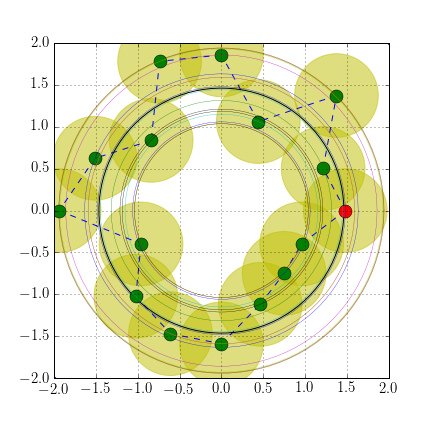
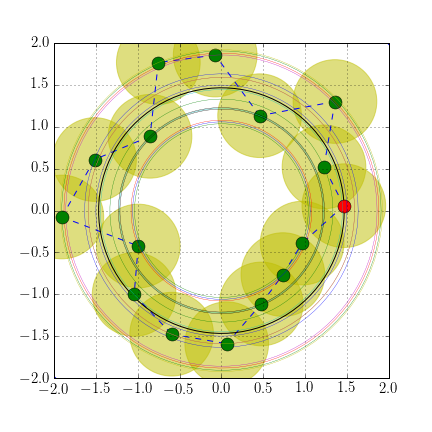
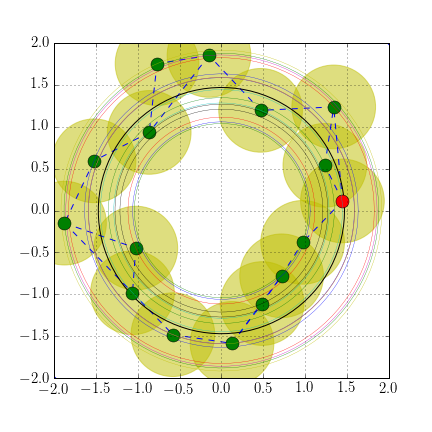
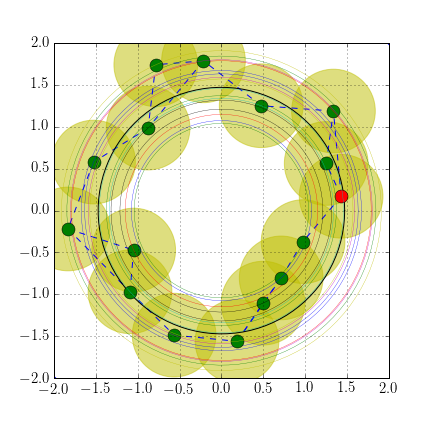
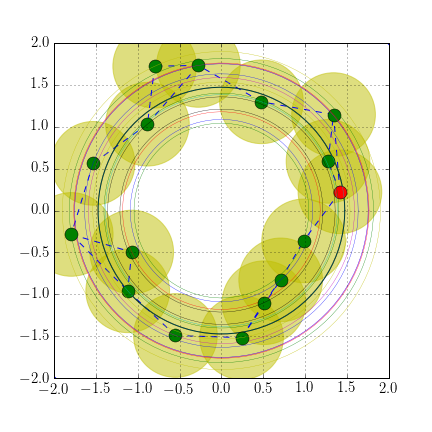
...
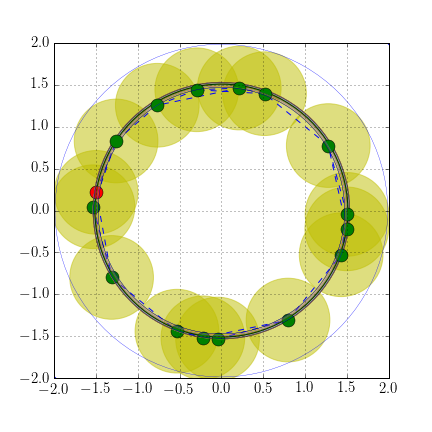
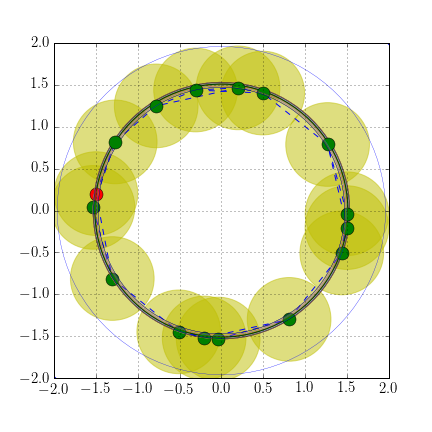
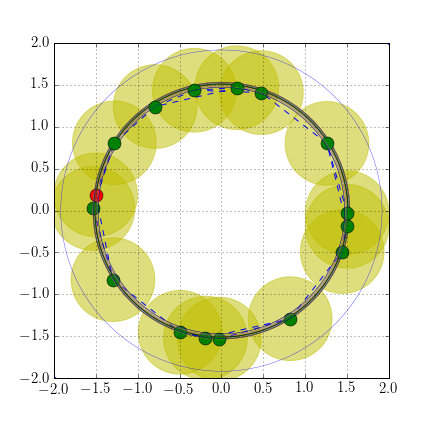
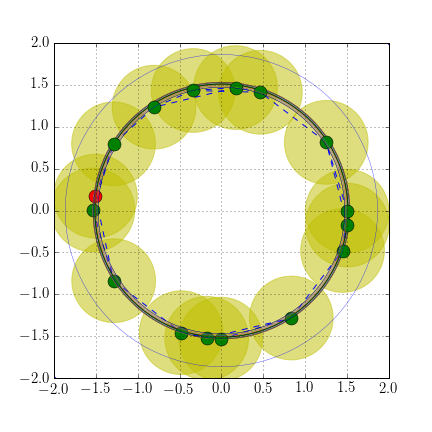
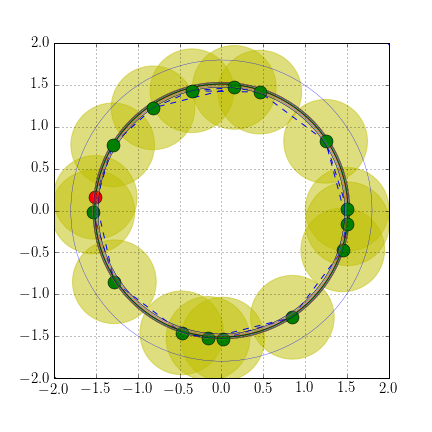

In [12]:
from JSAnimation import IPython_display
from matplotlib import animation

fig = plt.figure()
ax = plt.axes()

xsize, ysize = (-2, 2),(-2, 2)
    
xr = traj_rho * np.cos(traj_phi)
yr = traj_rho * np.sin(traj_phi)

def animate(t):       
    ax.clear()
    ax.plot(xsize, ysize, '.') 
    
    # Trajectories
    fig.gca().set_color_cycle(None)
    for i in range(n):
        ax.plot(xr[t-5:t+1,i], yr[t-5:t+1,i], 'y-')
    
    # Connections
    conn = np.triu(conns[t])
    edges = [(i,j) for i in range(n) for j in range(n) if conn[i][j]==1]

    for i,j in edges:
        ax.plot([xr[t][i],xr[t][j]], [yr[t][i],yr[t][j]], 'b--')
    
    # Circle
    brho =  np.mean(traj_rho[t])
    lphi = np.linspace(0, 2*math.pi, 100)
    pu = ax.plot(brho * np.cos(lphi), brho * np.sin(lphi), 'k-')
    
    # Robots
    fig.gca().set_color_cycle(None)
    for i in range(n):
        # Communication range
        circle1=plt.Circle((xr[t][i], yr[t][i]), .5, color='y', alpha=0.5)
        fig.gca().add_artist(circle1)
        #Robots
        marker = 'go' if not i in malicius else 'ro'
        ax.plot(xr[t][i], yr[t][i], marker, markersize=13)
        
        brho = traj_rho_comm[t][i]
        ax.plot(brho * np.cos(lphi), brho * np.sin(lphi), '-', linewidth=.3)
        
    

    ax.grid()
    return pu
    
anim = animation.FuncAnimation(fig, animate, frames=300, interval=100, blit=True)

#anim.save('encirclement_novel.mp4', dpi=300)
anim

# Malicious drawing (for Amanda)

In [13]:
def run_encirclement(n, phi, rho, neigh=1, malicius=[]):
    """
    neigh=1 means one neighbor in front and one back.
    """
    # Number of malicious agents
    F = len(malicius)
    
    # Trajectories
    traj_rho = [copy(rho)]
    traj_phi = [copy(phi)]
    
    # Trajectories communications
    traj_rho_comm = [copy(rho)]
    traj_phi_comm = [copy(phi)]
    
    # gain constants
    kp, kphi = .08, .00

    conns = []
    
    for ti in t:
        T = 8.5        
        PHI_COMM = math.pi/4.5
        # Adjacency matrix, based on phi
        conn = np.array([[diff_ang(i,j) for j in phi] for i in phi])
        conn = (abs(conn)<PHI_COMM)*1. - np.identity(n)        
        conns.append(conn)
        
        # old neighbors
        old_neigh = conns[-50:]
                
        # For each agent
        for i in range(n):
            # Phi for communication
            phi_comm = copy(phi)
            rho_comm = copy(rho)
            
            # Malicious agent
            for mi in malicius:
                phi_comm[mi] = 0
                rho_comm[mi] = 1.5+.5*math.sin(10*ti/T)
            
            # Neighbor indexes            
            neig = np.where(conn[i])
            # Rho from neighbors and i
            neig_rho = np.hstack((rho_comm[neig], rho[i]))
            brho = sum(neig_rho)/len(neig_rho)
            
            rho[i] += kp * (brho - rho[i])
                                    
                                    
            # Average
            phi_av = sum([phi_comm[i-j] for j in range(1, 1+neigh)] +
                         [phi_comm[(i+j) % n] for j in range(1, 1+neigh)]) / (2*neigh)
                       
            # Compensation for border nodes.
            if i < neigh:
                phi_av -= (neigh-i) * pi / neigh
            elif i >= n-neigh:
                phi_av += (i - n + neigh + 1) * pi / neigh            


            
            ### Oscillatory behavior
            a = .03
            
            phi[i] += Omeg
                        

        traj_rho.append(copy(rho))
        traj_phi.append(copy(phi))
        traj_rho_comm.append(copy(rho_comm))
        traj_phi_comm.append(copy(phi_comm))
        

    traj_rho = np.array(traj_rho)
    traj_phi = np.array(traj_phi)
    traj_rho_comm = np.array(traj_rho_comm)
    traj_phi_comm = np.array(traj_phi_comm)
    
    dot_phi = traj_phi[1:,:]-traj_phi[:-1,:]
    
    return traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns

traj_rho, traj_phi,traj_rho_comm, traj_phi_comm, dot_phi, conns = run_encirclement(n, copy(phi), copy(rho), neigh=1,
        malicius=[0])


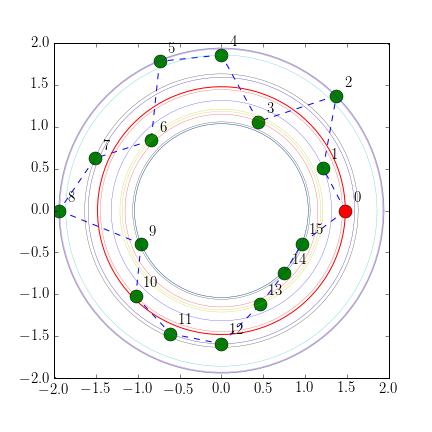
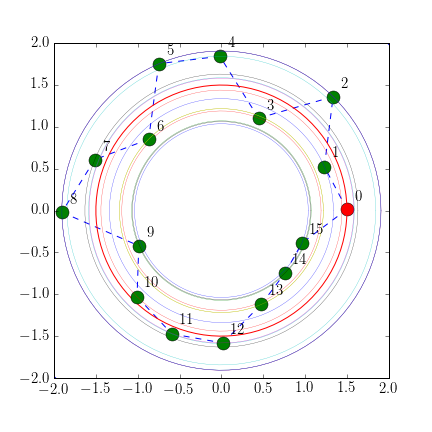
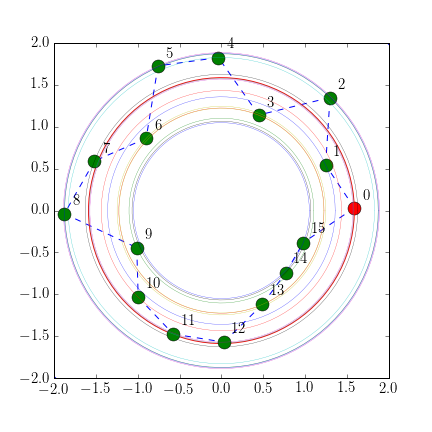
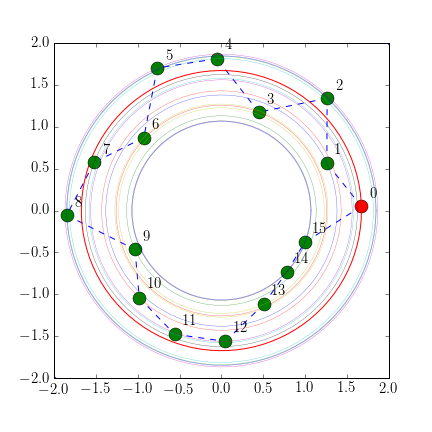
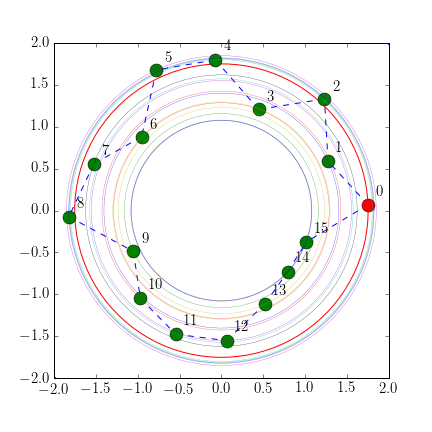
...
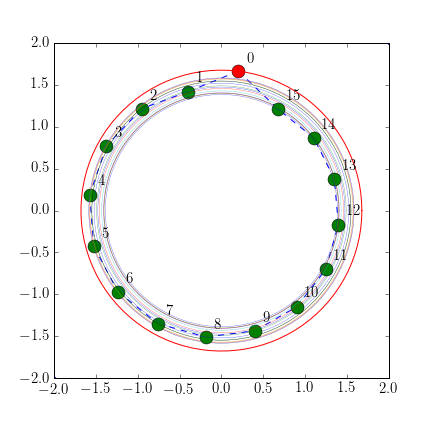
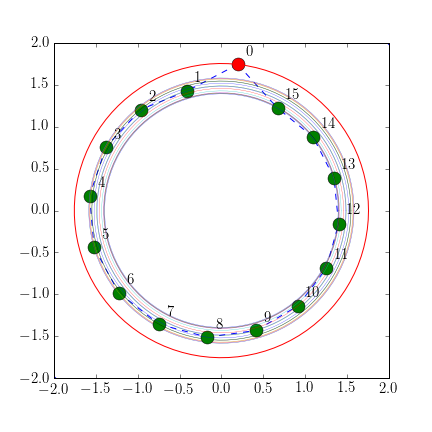
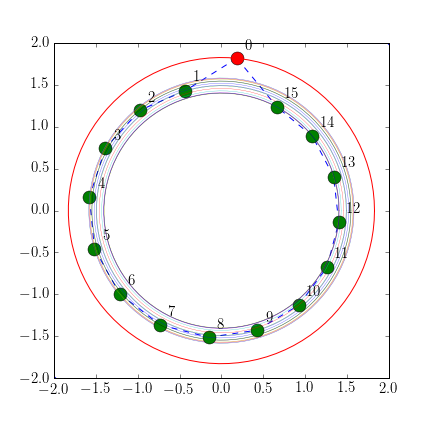
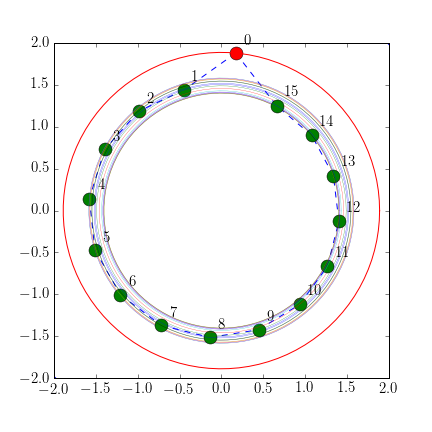
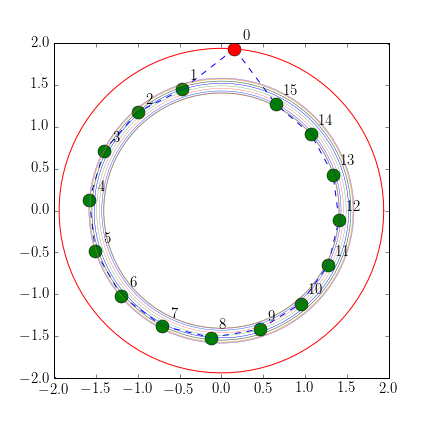

In [14]:
from JSAnimation import IPython_display
from matplotlib import animation

fig = plt.figure()
ax = plt.axes()

xsize, ysize = (-2, 2),(-2, 2)
    
xr = traj_rho_comm * np.cos(traj_phi)
yr = traj_rho_comm * np.sin(traj_phi)

def animate(t):       
    ax.clear()
    ax.plot(xsize, ysize, '.') 
    
    # Trajectories
#     fig.gca().set_color_cycle(None)
#     for i in range(n):
#         ax.plot(xr[t-5:t+1,i], yr[t-5:t+1,i], 'y-')
    
    # Connections
    conn = np.triu(conns[t])
    edges = [(i,j) for i in range(n) for j in range(n) if conn[i][j]==1]

    for i,j in edges:
        ax.plot([xr[t][i],xr[t][j]], [yr[t][i],yr[t][j]], 'b--')
    
    # Circle
    brho =  np.mean(traj_rho[t])
    lphi = np.linspace(0, 2*math.pi, 100)
#     pu = ax.plot(brho * np.cos(lphi), brho * np.sin(lphi), 'k-')
    
    # Robots
    fig.gca().set_color_cycle(None)
    for i in range(n):
        ax.text(xr[t][i]+.1, yr[t][i]+.10, '$'+str(i)+'$', fontsize=15)
        # Communication range
#         circle1=plt.Circle((xr[t][i], yr[t][i]), .5, color='y', alpha=0.5)
#         fig.gca().add_artist(circle1)
        #Robots
        marker = 'go' if not i in malicius else 'ro'
        ax.plot(xr[t][i], yr[t][i], marker, markersize=13)
        
        brho = traj_rho_comm[t][i]
        
        if i in malicius:
            pu = ax.plot(brho * np.cos(lphi), brho * np.sin(lphi), 'r-', linewidth=1.0)
        else:
            ax.plot(brho * np.cos(lphi), brho * np.sin(lphi), '-', linewidth=.3, alpha=0.8)
                

#     ax.grid()
    return pu
    
anim = animation.FuncAnimation(fig, animate, frames=150, interval=100, blit=True)

#anim.save('encirclement_novel.mp4', dpi=300)
anim

In [15]:
anim.save('encirclement_failed.mp4', dpi=300)

# Convergence

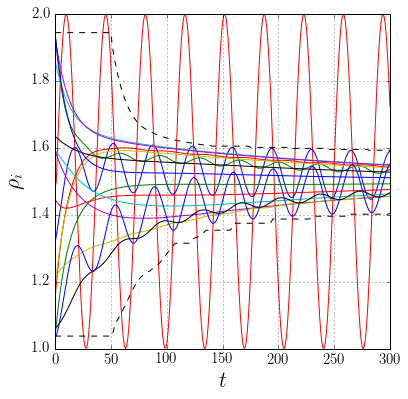

In [16]:


plt.grid()
#legend()
draw_rho(traj_rho_comm)

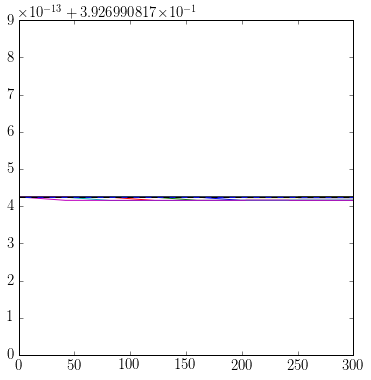

In [17]:
# Angular distance 
for i in range(1,n):
    plt.plot(traj_phi[:,i] - traj_phi[:,i-1], label="$\phi_%i$"%i)
    
plt.plot(np.ones(len(t))* 2*pi/(n), 'k--')

#legend(loc=1)

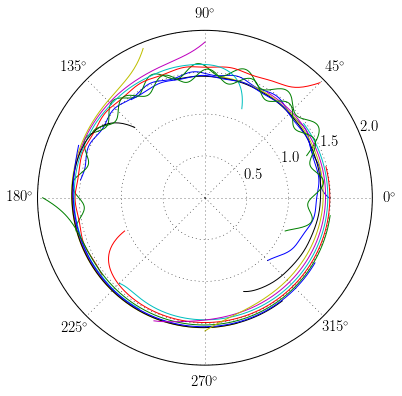

In [18]:
# Trajectories
for i in range(n):
    plt.polar(traj_phi[:,i], traj_rho[:,i], '-')